### Workflow stages

#### 1. Define problems for this competition and import the dataset
#### 2. Analyse the data
- Understand nature of the data .info() .describe()
- Histograms and boxplots 
- Value counts 
- Missing data 
- Correlation between the metrics 
- Explore interesting themes 
    - Timestamps
    - axis: X Y Z

- Feature engineering 
- preprocess data together or use a transformer? 
    - use label for train and test   
- Scaling?

#### 4. Divide the dataset. (train data and test data)
#### 5. Build a classifier using the algorithm of you choice and fit it with your train data
#### 6. Evaluate the model with your test data
#### 7. Fit your model with the complete dataset


###1. Define problems for the competition


In [1]:
# Import libraries

# pandas
import pandas as pd
from pandas import Series,DataFrame

# numpy, matplotlib, seaborn
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
%matplotlib inline

# machine learning
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB

In [2]:
# Import data from 
df_signals = pd.read_csv("bearing_signals.csv", low_memory=False)

In [3]:
df_classes = pd.read_csv("bearing_classes.csv",sep=";")

In [32]:
df_signals.shape
df_signals.info()
pd.set_option('display.max_columns',111)
df_signals.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10265700 entries, 0 to 10265699
Data columns (total 13 columns):
 #   Column         Dtype  
---  ------         -----  
 0   experiment_id  int64  
 1   bearing_1_id   int64  
 2   bearing_2_id   int64  
 3   timestamp      float64
 4   a1_x           float64
 5   a1_y           float64
 6   a1_z           float64
 7   a2_x           float64
 8   a2_y           float64
 9   a2_z           float64
 10  rpm            float64
 11  hz             float64
 12  w              float64
dtypes: float64(10), int64(3)
memory usage: 1018.2 MB


,experiment_id,bearing_1_id,bearing_2_id,timestamp,a1_x,a1_y,a1_z,a2_x,a2_y,a2_z,rpm,hz,w
count,1.026570e+07,10265700.0,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07,1.026570e+07
mean,5.658897e+01,0.0,5.658897e+01,1.556797e+01,-2.200731e-01,-4.832596e-02,-5.254890e-02,-3.124191e-01,-8.758339e-02,7.102206e-02,-2.760059e+05,-4.600098e+03,4.629741e-01
std,3.231361e+01,0.0,3.231361e+01,9.425589e+00,1.824082e+00,1.450662e+00,1.768919e+00,2.553113e+00,2.631378e+00,2.700098e+00,4.076958e+07,6.794930e+05,4.565080e-01
min,1.000000e+00,0.0,1.000000e+00,0.000000e+00,-1.604771e+01,-1.887183e+01,-1.633967e+01,-1.765083e+01,-1.873959e+01,-2.296248e+01,-6.000000e+09,-1.000000e+08,1.407501e-06
25%,2.900000e+01,0.0,2.900000e+01,7.638000e+00,-1.041087e+00,-6.073697e-01,-8.785304e-01,-1.602094e+00,-1.247228e+00,-1.040389e+00,4.774536e+02,7.957560e+00,4.778236e-02
50%,5.600000e+01,0.0,5.600000e+01,1.527633e+01,-1.753203e-01,-3.956274e-02,-1.424326e-02,-3.748382e-01,2.226305e-03,5.571547e-02,1.285714e+03,2.142857e+01,3.781180e-01
75%,8.500000e+01,0.0,8.500000e+01,2.291433e+01,5.942500e-01,5.282442e-01,8.500439e-01,8.524177e-01,8.672333e-01,1.151820e+00,1.487603e+03,2.479339e+01,7.271071e-01
max,1.120000e+02,0.0,1.120000e+02,5.549967e+01,1.560087e+01,1.614294e+01,1.640721e+01,1.916685e+01,2.249241e+01,2.596364e+01,9.000135e+04,1.500023e+03,9.393605e+00


In [5]:
print(df_signals.columns)
print(df_classes.columns)

Index(['experiment_id', 'bearing_1_id', 'bearing_2_id', 'timestamp', 'a1_x',
       'a1_y', 'a1_z', 'a2_x', 'a2_y', 'a2_z', 'rpm', 'hz', 'w'],
      dtype='object')
Index(['bearing_id', 'status'], dtype='object')


In [6]:
df_signals.experiment_id.unique()

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112])

In [27]:
print(df_signals.timestamp.unique())
print(df_signals.timestamp.nunique())


[0.00000000e+00 3.33333333e-04 6.66666667e-04 ... 5.54990000e+01
 5.54993333e+01 5.54996667e+01]
166500


In [29]:
df_signals.isnull().sum()

experiment_id    0
bearing_1_id     0
bearing_2_id     0
timestamp        0
a1_x             0
a1_y             0
a1_z             0
a2_x             0
a2_y             0
a2_z             0
rpm              0
hz               0
w                0
dtype: int64

In [38]:
for col in df_signals.select_dtypes('float64'):
    print(f"{col} has {(df_signals[col]==0).sum()} zero values")

timestamp has 112 zero values
a1_x has 0 zero values
a1_y has 0 zero values
a1_z has 0 zero values
a2_x has 0 zero values
a2_y has 0 zero values
a2_z has 0 zero values
rpm has 366785 zero values
hz has 366785 zero values
w has 0 zero values


In [25]:
df0 = df_signals[df_signals['timestamp'] == 0]
df0.shape

(112, 13)

In [9]:
df = df_signals[df_signals['timestamp'] != 0]
df.shape

(10265588, 13)

In [10]:
df.tail()

,experiment_id,bearing_1_id,bearing_2_id,timestamp,a1_x,a1_y,a1_z,a2_x,a2_y,a2_z,rpm,hz,w
10265695,112,0,112,32.098333,-0.367713,0.149706,0.465916,-0.469243,0.194450,0.553945,178.748759,2.979146,0.019412
10265696,112,0,112,32.098667,-0.463909,0.338975,0.561948,-0.469243,0.194450,0.354653,178.748759,2.979146,0.032027
10265697,112,0,112,32.099000,0.017072,0.433610,0.369884,-0.563647,-0.093886,0.155361,178.748759,2.979146,0.012211
10265698,112,0,112,32.099333,0.209465,0.244341,0.273852,-0.374838,0.194450,0.155361,178.748759,2.979146,0.000764
10265699,112,0,112,32.099667,0.498054,0.244341,0.177821,-0.186030,0.290562,-0.243222,178.748759,2.979146,0.002794


In [11]:
df = df.sort_values(by = ['experiment_id', 'timestamp'], ignore_index=True)
df.tail()

# We don't have to do this because, dataset has been sorted

,experiment_id,bearing_1_id,bearing_2_id,timestamp,a1_x,a1_y,a1_z,a2_x,a2_y,a2_z,rpm,hz,w
10265583,112,0,112,32.098333,-0.367713,0.149706,0.465916,-0.469243,0.194450,0.553945,178.748759,2.979146,0.019412
10265584,112,0,112,32.098667,-0.463909,0.338975,0.561948,-0.469243,0.194450,0.354653,178.748759,2.979146,0.032027
10265585,112,0,112,32.099000,0.017072,0.433610,0.369884,-0.563647,-0.093886,0.155361,178.748759,2.979146,0.012211
10265586,112,0,112,32.099333,0.209465,0.244341,0.273852,-0.374838,0.194450,0.155361,178.748759,2.979146,0.000764
10265587,112,0,112,32.099667,0.498054,0.244341,0.177821,-0.186030,0.290562,-0.243222,178.748759,2.979146,0.002794


In [12]:
# drop columns
df.drop(columns=['bearing_1_id','bearing_2_id','rpm'],inplace=True)
print(df.shape)
df.head()

(10265588, 10)


,experiment_id,timestamp,a1_x,a1_y,a1_z,a2_x,a2_y,a2_z,hz,w
0,1,0.000333,-0.367713,-0.228832,0.177821,0.285992,0.002226,-0.043930,0.0,0.000243
1,1,0.000667,0.113269,0.149706,-0.398371,-0.091625,0.002226,0.454299,0.0,0.000369
2,1,0.001000,-0.175320,-0.228832,-0.110275,0.285992,0.002226,0.255007,0.0,0.000520
3,1,0.001333,-0.079124,0.055072,-0.110275,0.191588,0.002226,0.255007,0.0,0.000175
4,1,0.001667,-0.175320,-0.039563,-0.110275,0.191588,0.194450,0.255007,0.0,0.000520


array([[<AxesSubplot:title={'center':'timestamp'}>]], dtype=object)

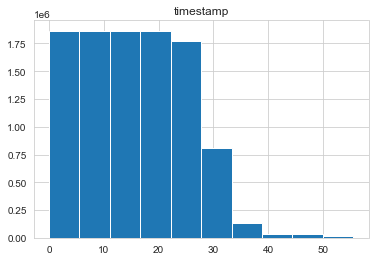

In [13]:
df.hist('timestamp')#counted by second

array([[<AxesSubplot:title={'center':'status'}>]], dtype=object)

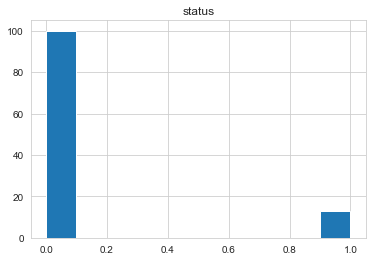

In [14]:
df_classes.hist('status')#counted by second

####Features:
**Vibration**: 
- {rotation speed1-rpm/revolutions per minutes; 
- hz: rotation speed2 in Hertz; 
- w: power of the motor at a time, measured in Watts}
**Acceleration**: timestamp, 3d axis (X,Y,Z), Bearing 1, Bearing 2: movement between
- timestamp
- a1_x, a2_x
- a1_y, a2_y
- a1_z, a2_z

**Target** Defection: {good: 1, failure:0}

#### Content
 - For the experiments device shown on the picture was constructed. Two bearings were installed on the shaft. The rotation speed changed from 0 to 1500 rpm, was held for 10 seconds, and decreased to 250 rpm. The shaft was rotated using an DC motor connected to the shaft through a coupling. A radial load of 3.5 kg is applied to the shaft using a balanced weight.
 - The bearings were mounted on the shaft as shown in Figure 1. GY-61 ADXL3353 accelerometers were mounted on the bearing housing 
 - The sensor location is also shown in Figure. The recording was saved along the x, y, z axes.

In [15]:
df_classes.tail(20)

,bearing_id,status
93,93,0
94,94,0
95,95,0
96,96,0
97,97,0
98,98,0
99,99,0
100,100,0
101,101,1
102,102,1


In [16]:
df_classes.status.value_counts()

0    100
1     13
Name: status, dtype: int64

In [17]:
id_experiment = 110
df_experiment110 = df_signals[df_signals['experiment_id']==id_experiment]

In [18]:
print(df_experiment110.shape[0])
print(df_signals.shape[0])
print(df_classes.shape[0])

87900
10265700
113


In [19]:
len(df_signals['experiment_id'].unique())

112

In [24]:
# Function to generate experement dataset from df_signals

def generate_dataset(dataframe, exp_nr):
    if exp_nr <= (len(dataframe.experiment_id.unique())):
        return pd.DataFrame(dataframe[dataframe.experiment_id == exp_nr])

df12 = generate_dataset(df, 12)        
print(df12.shape)

(87299, 10)


## Some visualisation of experiments


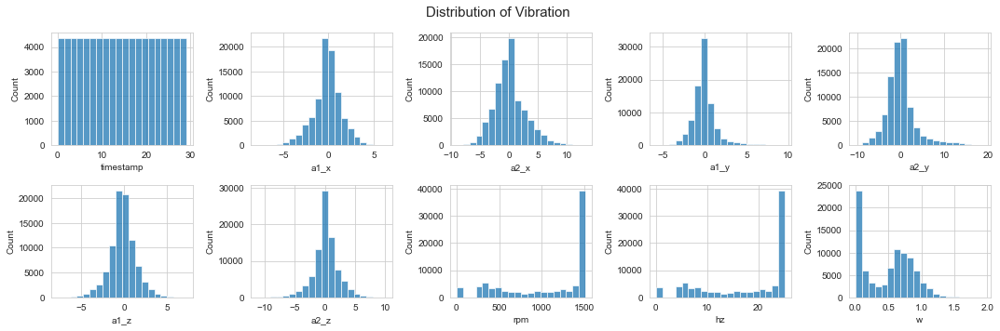

In [21]:
num_feature = ["timestamp","a1_x","a2_x", "a1_y", "a2_y", "a1_z", "a2_z", "rpm", "hz", "w"]
enum_feature = list(enumerate(num_feature))

plt.figure(figsize=(15,5))
plt.suptitle("Distribution of Vibration ", fontsize=15)
    
# Histogram    
for i in enum_feature:
    plt.subplot(2,5,i[0]+1)
    sns.histplot(data = df12[i[1]], palette="rainbow", bins=20)
    plt.xlabel(str(i[1]))


plt.tight_layout()
plt.show()

In [22]:
df12.timestamp.sort_values(inplace=False).value_counts()

0.000000     1
15.589000    1
8.955333     1
7.318333     1
14.202667    1
            ..
21.142333    1
13.603000    1
2.019333     1
8.725333     1
4.937000     1
Name: timestamp, Length: 87300, dtype: int64

In [23]:
df12[df12.timestamp ==0]

,experiment_id,bearing_1_id,bearing_2_id,timestamp,a1_x,a1_y,a1_z,a2_x,a2_y,a2_z,rpm,hz,w
939600,12,0,12,0.0,0.113269,0.055072,-0.494403,0.285992,0.19445,0.155361,0.0,0.0,0.000023


In [48]:
import plotly.express as px # library for plotting


fig = px.line(df12, x="timestamp", y=["a2_y","a1_y"], title='The vibration both accelerometers by axis y')
fig.show()

In [49]:
fig = px.line(df12, x="timestamp", y=["a2_z","a1_z"], title='The vibration both accelerometers by axis z')
fig.show()

In [50]:
fig = px.line(df12, x="timestamp", y=["hz"], title='The speed motor of Experiment 12')
fig.show()

In [51]:
#print(df_signals.describe())
signal_over27 = df_signals[df_signals.hz > 27]
print(len(signal_over27))
signal_over27.experiment_id.unique()

#we detected 12 experiment has outliers (hz > 27)

4599


array([ 8, 11, 14, 15, 17, 19, 21, 23, 24, 29, 36, 81])

In [45]:
fig = px.line(signal_over27, x="timestamp", y=["hz"], title='The speed motor ')
plt.tight_layout()
fig.show()

<Figure size 432x288 with 0 Axes>

In [52]:
#print(df_signals.describe())
signal_over200 = df[df.hz > 200]
print(len(signal_over200))
signal_over200.experiment_id.unique()

#we detected 12 experiment has outliers (hz > 200)

3629


array([ 8, 11, 14, 17, 19, 23, 24, 29, 36, 81])

In [42]:
df8 = generate_dataset(df, 8)        
df8.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 81299 entries, 595193 to 676491
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   experiment_id  81299 non-null  int64  
 1   timestamp      81299 non-null  float64
 2   a1_x           81299 non-null  float64
 3   a1_y           81299 non-null  float64
 4   a1_z           81299 non-null  float64
 5   a2_x           81299 non-null  float64
 6   a2_y           81299 non-null  float64
 7   a2_z           81299 non-null  float64
 8   hz             81299 non-null  float64
 9   w              81299 non-null  float64
dtypes: float64(9), int64(1)
memory usage: 6.8 MB


#### Are the features independent? Plot co-variance matrix
It can be seen that there are some good amount of correlation between features i.e. they are not independent of each other, as assumed in Naive Bayes technique. However, we will still go ahead and apply yhe classifier to see its performance.

<ipython-input-53-5ee79f20d25d>:12: UserWarning:

FixedFormatter should only be used together with FixedLocator

<ipython-input-53-5ee79f20d25d>:13: UserWarning:

FixedFormatter should only be used together with FixedLocator



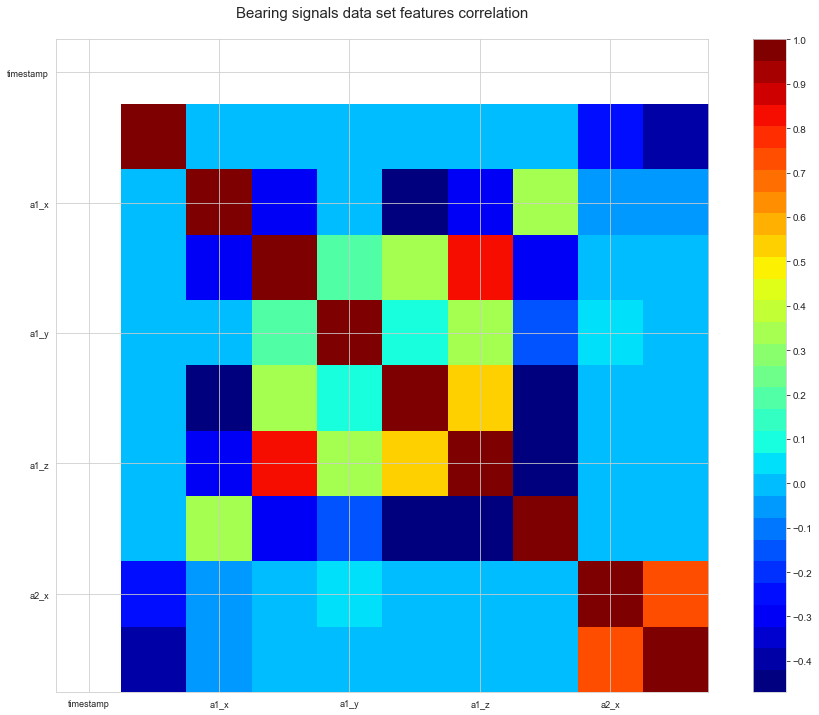

In [53]:
def correlation_matrix(df):
    from matplotlib import pyplot as plt
    from matplotlib import cm as cm

    fig = plt.figure(figsize=(16,12))
    ax1 = fig.add_subplot(111)
    cmap = cm.get_cmap('jet', 30)
    cax = ax1.imshow(df.corr(), interpolation="nearest", cmap=cmap)
    ax1.grid(True)
    plt.title('Bearing signals data set features correlation\n',fontsize=15)
    labels=df.columns
    ax1.set_xticklabels(labels,fontsize=9)
    ax1.set_yticklabels(labels,fontsize=9)
    # Add colorbar, make sure to specify tick locations to match desired ticklabels
    fig.colorbar(cax, ticks=[0.1*i for i in range(-11,11)])
    plt.show()

correlation_matrix(df12)

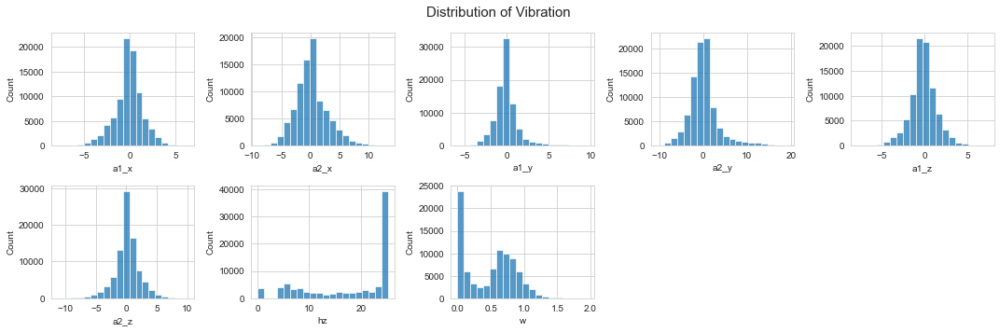

In [56]:
num_feature = ["a1_x","a2_x", "a1_y", "a2_y", "a1_z", "a2_z", "hz", "w"]
enum_feature = list(enumerate(num_feature))

plt.figure(figsize=(15,5))
plt.suptitle("Distribution of Vibration ", fontsize=15)
    
# Histogram    
for i in enum_feature:
    plt.subplot(2,5,i[0]+1)
    sns.histplot(data = df12[i[1]], palette="rainbow", bins=20)  #change df here
    plt.xlabel(str(i[1]))


plt.tight_layout()
plt.show()

#the shape of rpm and hz is similar -> reduce it (rpm)

In [58]:
# get steady speed Hz
steady_filter = (df12['hz'] > 20) & (df12['hz'] < 25.21)
experiment_steady_speed = df12[steady_filter]

In [59]:
fig = px.line(experiment_steady_speed, x="timestamp", y=["hz"], title='The speed motor ')
fig.show()

In [60]:
experiment_steady_speed['a2_y'].describe()

count    48184.000000
mean        -0.032178
std          4.140492
min        -10.377857
25%         -2.496683
50%         -0.766669
75%          1.540016
max         19.224603
Name: a2_y, dtype: float64

In [61]:
raw_signal_a1_y = experiment_steady_speed['a1_y']
raw_signal_a2_y = experiment_steady_speed['a2_y']

In [62]:
import collections
 
from scipy.stats import entropy
  
def get_shannon_entropy(signal):
    bases = collections.Counter([tmp_base for tmp_base in signal])
    # define distribution
    dist = [x/sum(bases.values()) for x in bases.values()]
 
    # use scipy to calculate entropy
    entropy_value = entropy(dist, base=2)
 
    return entropy_value

print(get_shannon_entropy(raw_signal_a1_y))
print(get_shannon_entropy(raw_signal_a2_y))

6.090034819703172
7.244559199650367


In [63]:
def get_current_rate(df, step):
    time_step = df['timestamp'].iloc[step+1] - df['timestamp'].iloc[step]
    sample_rate = 1.0 / time_step
    cur_freq = df['hz'].iloc[step]
    return cur_freq, sample_rate

In [ ]:
from scipy.fft import fft, fftfreq

def get_fft(df,fs):
    N=len(df)
    fs = fs
    x_plot= fftfreq(N, 1/fs)[:N//2]
    
    df_fft = pd.DataFrame()
    df_phase = pd.DataFrame()
    for name in df.columns:
        yf = fft(df[name].values) 
        y_plot= 2.0/N * np.abs(yf[0:N//2])
        df_fft = pd.concat([df_fft,
                            pd.DataFrame({'Frequency (Hz)':x_plot[1:],
                                          name:y_plot[1:]}).set_index('Frequency (Hz)')],axis=1)
    
    return df_fft

A **Power Spectral Density (PSD)** is the measure of signal's power content versus frequency. A PSD is typically used to characterize broadband random signals. The amplitude of the PSD is normalized by the spectral resolution employed to digitize the signal.

In [64]:
import scipy.signal as signal

#
def get_psd(df,bin_width,fs):
    fs = fs   
    f, psd = signal.welch(df.to_numpy(), 
                          fs=fs, 
                          nperseg=fs/bin_width,
                          window='hanning',
                          axis=0
                         )

    df_psd = pd.DataFrame(psd,columns=df.columns)
    df_psd.columns
    df_psd['Frequency (Hz)'] = f
    df_psd = df_psd.set_index('Frequency (Hz)')
    return df_psd[1:] #drop the first value because it makes the plots look bad and is effectively 0

## Creating some functions for feature extraction from vibration data

#### Some functions for working with data

In [65]:
# Standard deviation is a statistical metric defining the amount of variation in the signal
def get_std(signal):
    return signal.std()

get_std(df_signals)

#Variance measures the dispersion of a signal around their reference mean value.
def get_variance(signal):
    return signal.var()

#Skewness quantifies the asymmetry behavior of vibration signal through its probability density function (PDF).
def get_skewness(signal):
    return signal.skew()

#Kurtosis quantifies the peak value of the PDF. 
#The kurtosis value for normal rolling element bearing is well-recognized as 3
def get_kurtosis(signal):
    return signal.kurtosis()

#Shape factor is a value that is affected by an object’s shape but is independent of its dimensions.
def get_shape_factor(signal):
    N = len(signal)
    return np.sqrt(((signal**2).sum()/N) / ((signal.abs()).sum()/N))

In [72]:
#Entropy is a calculation of the uncertainty and randomness of a sampled vibration data.
from math import log, e

def get_entropy(signal, base=None):
    vc = signal.value_counts(normalize=True, sort=False)
    base = e if base is None else base
    return -(vc * np.log(vc)/np.log(base)).sum()

# Impulse Factor is used to measure how much impact is generated from the bearing defect. 
#IF divides the maximum absolute value by the mean of absolute value.
def get_impulse_factor(signal):
    return signal.abs().max() / (signal.abs().sum() / len(signal))

# Margin factor (MF) measures the level of impact between rolling element and raceway. 
#The MF is calculated by dividing the maximum absolute value of vibration signal to 
#the RMS of absolute value of vibration signal

def get_margin_factor(signal):
    signal = signal.to_numpy()
    return np.max(np.abs(signal)) / ((np.sum(np.sqrt(np.abs(signal)))/ len(signal))**2)

Hjorts’ parameters are calculated based on the first and the second derivatives of the vibration signal. In the time series context, the numerical values for the derivatives are obtained as the differences between the current value and the prior value. There are three parameters: activity, mobility, complexity. These parameters have been used in electroencephalography (EEG) signals to detect the epileptic seizures. They have never been used in vibration bearing signal except for activity feature, which is similar to the variance feature in the statistical time-domain features extraction.

In [66]:
#Hjorts’ parameters
def get_hjorts_parameters(signal):
    first_diff = signal.diff()
    first_diff_std = first_diff.std()
    second_diff = signal.diff().diff()
    std = signal.std()
    activity_hjorts_parameters = std**2
    mobility_hjorts_parameters = first_diff.std()/std
    complexity_hjorts_parameters = (second_diff.std()/first_diff_std )/ (first_diff_std / std)
    return [activity_hjorts_parameters, mobility_hjorts_parameters, complexity_hjorts_parameters]

In [67]:
def get_frequency_centre(signal):
    return ((signal.diff()*signal).sum()) / (2 * np.pi * np.sum(signal**2))
def get_mean_square_frequency(signal):
    return  np.sum(signal.diff()**2) / (4 * np.pi**2 * np.sum(signal**2))
def get_root_mean_square_frequency(signal):
    return  np.sqrt(get_mean_square_frequency(signal))
def get_root_variance_frequency(signal):
    return  np.sqrt(get_mean_square_frequency(signal) - get_frequency_centre(signal)**2)

### ***Peak acceleration*** may be easy, but it is often very misleading. 
And you can see in the table above that although there is some correlation between 
the significance of the fault and the peak acceleration, it isn't a perfect correlation. 
Peak acceleration values can be too dependent on a bit of chance with how the sampling lines up with the data. 
Meaning when you are comparing multiple signals to each other, any difference in sample rate or low-pass filters 
will make the comparison between the peak accelerations inappropriate and even more misleading than normal.

In [68]:
def get_peak_acceleration(signal):
    return pd.DataFrame.max(signal.abs())

**RMS** is by far my preference over peak because it is independent of the sample rate and it will more accurately let you compare the vibration levels of two signals. The RMS value increase gradually as fault developed. However, RMS is unable to provide the information of incipient fault stage while it increases with the fault development.

Root mean square (RMS)

In [69]:
def get_rms_acceleration(signal):
    N = len(signal)
    return np.sqrt(1/N * (signal**2).sum())

In [70]:
def get_crest_factor(signal):
    return get_peak_acceleration(signal)/get_rms_acceleration(signal)


In [73]:
list_features_function = [get_peak_acceleration, 
                          get_rms_acceleration, 
                          get_crest_factor,
                          get_std, 
                          get_variance,
                          get_skewness, 
                          get_kurtosis, 
                          get_shape_factor, 
                          get_entropy, 
                          get_impulse_factor, 
                          get_margin_factor,
                          get_hjorts_parameters, 
                          get_frequency_centre, 
                          get_mean_square_frequency, 
                          get_root_mean_square_frequency,
                          get_root_variance_frequency]

In [74]:
# RUN each of experiment_id with the collection of functions
experiment_ls = df_signals['experiment_id'].unique()
data_stationary_features = []
for exp in experiment_ls:
    df_experiment = df_signals[(df_signals['experiment_id']==exp)]
    steady_filter = (df_experiment['hz'] > 22) & (df_experiment['hz'] < 25.3)
    experiment_steady = df_experiment[steady_filter]
    feature_a1_y = []
    feature_a2_y = []
    for func in list_features_function:
        a1 = func(experiment_steady['a1_y'])
        a2 = func(experiment_steady['a2_y'])
        if type(a1) == list:
            feature_a1_y+=a1
            feature_a2_y+=a2
            
        else:
            feature_a1_y.append(a1)
            feature_a2_y.append(a2)
    data_stationary_features.append((feature_a1_y,feature_a2_y))

In [77]:
print(len(data_stationary_features))
data_stationary_features[:,0,:]

112


array([[5.16533453e+00, 1.23870882e+00, 4.16993442e+00, ...,
        4.65269405e-03, 6.82106594e-02, 6.66262102e-02],
       [4.02972058e+00, 1.07443286e+00, 3.75055597e+00, ...,
        5.41913182e-03, 7.36147527e-02, 7.16191924e-02],
       [4.59752756e+00, 1.09059775e+00, 4.21560338e+00, ...,
        6.00646293e-03, 7.75013737e-02, 7.51690909e-02],
       ...,
       [6.19080497e+00, 1.46013273e+00, 4.23989193e+00, ...,
        3.32214091e-03, 5.76380162e-02, 5.66846869e-02],
       [4.77128753e+00, 1.22753313e+00, 3.88689106e+00, ...,
        5.26542731e-03, 7.25632642e-02, 7.06515999e-02],
       [5.71763249e+00, 1.32964498e+00, 4.30011963e+00, ...,
        5.70973179e-03, 7.55627672e-02, 7.34027180e-02]])

In [78]:
data_stationary_features = np.array(data_stationary_features,ndmin=3)
df_first = pd.DataFrame(data_stationary_features[:,0,:]) # df_first is dataframe of the features first bearing in each experiment
df_second = pd.DataFrame(data_stationary_features[:,1,:])# df_second is dataframe of the features second bearing in each experiment

In [80]:
print(df_first.shape)
df_first.describe()

(112, 18)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
count,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000,112.000000
mean,7.933035,1.722729,4.557841,1.709667,3.341380,0.380771,0.582970,1.460185,4.190306,5.840928,6.942640,3.341380,0.448718,3.017438,0.017119,0.005449,0.070983,0.068695
std,3.462279,0.690793,0.560062,0.649760,2.714403,0.411802,0.842529,0.288985,0.333460,0.841348,1.081319,2.714403,0.134614,0.677019,0.010535,0.003353,0.020348,0.018162
min,3.840452,0.868592,3.426662,0.868572,0.754417,-0.321374,-0.536084,1.048838,3.597749,4.229338,4.902936,0.754417,0.276334,1.489628,0.006076,0.001934,0.043978,0.043557
25%,5.070700,1.205412,4.212738,1.205269,1.452687,0.060404,0.002568,1.224111,3.926562,5.266512,6.184227,1.452687,0.337741,2.493486,0.009078,0.002890,0.053752,0.052980
50%,6.624415,1.462585,4.450794,1.461433,2.135798,0.261565,0.244955,1.362366,4.122003,5.651885,6.679489,2.135798,0.428344,3.051117,0.014598,0.004647,0.068166,0.066584
75%,10.441208,2.087600,4.845992,2.087572,4.357958,0.691824,1.071564,1.656167,4.424608,6.306283,7.557810,4.357958,0.516202,3.499914,0.021195,0.006746,0.082134,0.079352
max,18.871827,4.426004,6.348390,3.969314,15.755451,1.292292,3.064937,2.361310,5.119200,8.539486,10.337227,15.755451,0.927774,4.740456,0.067752,0.021566,0.146855,0.130292


In [81]:
fig =px.bar(df_first)
fig.update_yaxes(range=[0,150])
fig.show()

In [82]:
fig =px.bar(df_second)
fig.update_yaxes(range=[0,150])
fig.show()

In [ ]:
#experiment_ls = df_signals['experiment_id'].unique()
print(df_signals[df_signals.experiment_id == 101].info())
print(df_signals[df_signals.experiment_id == 102].info())

In [84]:
from scipy import interpolate
experiments = df_signals['experiment_id'].unique()
#experiments = experiments[experiments != 101]
#experiments = experiments[experiments != 102]
print(experiments)
X = []
y = []
X_fft = []
X_chunks = []
id_experience_test = np.random.choice(experiments[:100],size=20, replace=False)
id_experience_test = np.append(id_experience_test,np.random.choice(experiments[100:],size=5, replace=False))
print(id_experience_test)

[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112]
[ 56  11  50  57  33  44  30  25  53  93  20  17  29  76  34   6 100  98
  89  70 104 103 106 110 111]


In [86]:
N=len(df_experiment)
N

85199

In [91]:
x_fft_validation = []
x_chunks_validation = []
x_validation = []
y_validation = []

experiments = df['experiment_id'].unique()
for exp in experiments:
    # print(exp)
    df_experiment = df[(df['experiment_id']==exp)]
    steady_filter = (df_experiment['hz'] > 22) & (df_experiment['hz'] < 25.5)
    experiment_steady = df_experiment[steady_filter]
    sig = experiment_steady['a2_y']
    
    y = int(df_classes[(df_classes['bearing_id'] == exp)]['status'])
    #print(len(sig))
    N=len(sig) #check again???
    
    chunks = [sig[i:i + N] for i in range(0, len(sig), N)]
    chunks.pop(-1)
    
    for chunk in chunks:
        
        features = []
        for func in list_features_function:
            a1 = func(chunk)
            if type(a1) == list:
                features+=a1
            else:
                features.append(a1)
        
        fft_ = get_fft(pd.DataFrame(chunk), 3000)

        freq = fft_['a2_y'].index.to_numpy()
        val = fft_['a2_y'].to_numpy()
        mean_speed = experiment_steady['hz'].mean()
        val_normalized = val/mean_speed
        
        interpolate_function_fft = interpolate.interp1d(freq, val_normalized, kind = 'linear')

        start_hz = 1
        end_hz = 200
        step = 1

        freq_new = np.arange(start_hz,end_hz + 1,step)
        val_new = interpolate_function_fft(freq_new)
        
        if exp not in id_experience_test:
            X_fft.append(val_new[:end_hz])
            X_chunks.append(chunk)
            X.append(features)
            Y.append(y)
        else:
            x_fft_validation.append(val_new[:end_hz])
            x_chunks_validation.append(chunk)
            x_validation.append(features)
            y_validation.append(y)

In [89]:
np.array(X).shape

(0,)

ValueError: Expected 2D array, got 1D array instead:
array=[].
Reshape your data either using array.reshape(-1, 1) if your data has a single feature or array.reshape(1, -1) if it contains a single sample.

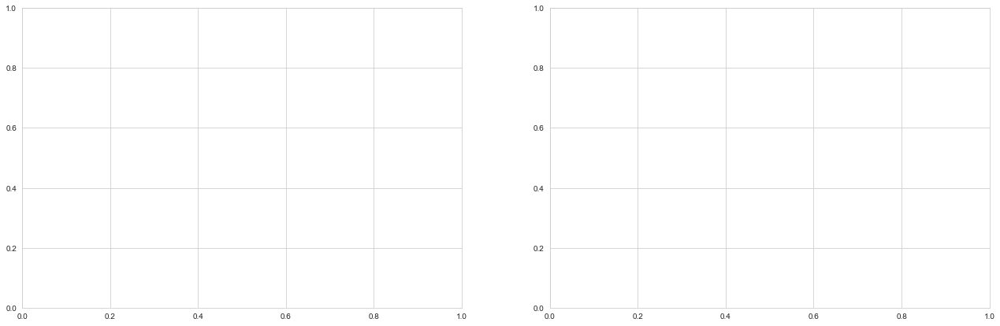

In [92]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import plot_roc_curve
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_det_curve
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB

import matplotlib.pyplot as plt

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=15, shuffle=True)
X_train, y_train = X_chunks, Y
# X_train, X_test, y_train, y_test = train_test_split(X_fft, y, test_size=0.3, random_state=15, shuffle=True)
classifiers = {
    "Linear SVM": make_pipeline(StandardScaler(), SVC(gamma='auto', kernel="rbf")),
    "Random Forest": RandomForestClassifier(
        max_depth=5, n_estimators=10, max_features=1, class_weight='balanced'
    ),
    "DecisionTreeClassifier": DecisionTreeClassifier(random_state=0),
    "AdaBoostClassifier": AdaBoostClassifier(n_estimators=100, random_state=0),
    "KNeighbor": KNeighborsClassifier(n_neighbors=6),
    "GradientBoostingClassifier": GradientBoostingClassifier(n_estimators=100, learning_rate=1.0, max_depth=1, random_state=0),
    "GaussianProcessClassifier": GaussianProcessClassifier(kernel=1.0 * RBF(1.0),random_state=0),
    "LogisticRegression": LogisticRegression(random_state=0, solver='lbfgs'),
    'MLPCLassifier': MLPClassifier(random_state=1),
    "GaussianNB":GaussianNB()
    
}


fig, [ax_roc, ax_det] = plt.subplots(1, 2, figsize=(22, 7))
for name, clf in classifiers.items():
    clf.fit(X_train, y_train)
    y_predict = clf.predict(x_chunks_validation)
    
    print("\n\n" + name + "\n\n")
    print("\n" + "Metrics:" + "\n")
    print(classification_report(y_validation, y_predict))
    print("\n")
    print("\n" + "Confusion Matrix:" + "\n")
    print(confusion_matrix(y_validation, y_predict))
    print("\n", 30*"==","\n")

    plot_roc_curve(clf, x_chunks_validation, y_validation, ax=ax_roc, name=name)
    plot_det_curve(clf, x_chunks_validation, y_validation, ax=ax_det, name=name)
plt.show()

**The Fast Fourier Transform (FFT)**  
and the power spectrum are powerful tools for analyzing and measuring signals
from plug-in data acquisition (DAQ) devices. 

- For example, you can effectively acquire time-domain signals, measure the frequency content, and convert the results to real-world units and displays as shown on traditional benchtop spectrum and network analyzers. By using plug-in DAQ devices, you can build a lower cost measurement system and avoid the communication overhead of working with a stand-alone instrument. Plus, you have the flexibility of configuring your measurement processing to meet your needs.
- To perform FFT-based measurement, however, you must understand the fundamental issues and computations involved. This application note serves the following purposes.
  • Describes some of the basic signal analysis computations,
  • Discusses antialiasing and acquisition front ends for FFT-based signal analysis,
  • Explains how to use windows correctly,
  • Explains some computations performed on the spectrum, and
  • Shows you how to use FFT-based functions for network measurement.
- The basic functions for FFT-based signal analysis are the FFT, the Power Spectrum, and the Cross Power Spectrum.
- Using these functions as building blocks, you can create additional measurement functions such as frequency response, impulse response, coherence, amplitude spectrum, and phase spectrum.
- FFTs and the Power Spectrum are useful for measuring the frequency content of stationary or transient signals. FFTs produce the average frequency content of a signal over the entire time that the signal was acquired. For this reason, you should use FFTs for stationary signal analysis or in cases where you need only the average energy at each frequency line. To measure frequency information that is changing over time, use joint time-frequency functions such as the Gabor Spectrogram.
- This application note also describes other issues critical to FFT-based measurement, such as the characteristics of the signal acquisition front end, the necessity of using windows, the effect of using windows on the measurement, and measuring noise versus discrete frequency components.

In [ ]:
from scipy import interpolate

experiments = df_signals['experiment_id'].unique()

data_fft_features = []
for exp in experiments:
    experiment = df_signals[(df_signals['experiment_id']==exp)]
    steady_filter = (experiment['hz'] > 24) & (experiment['hz'] < 26)
    
    experiment_steady_speed = experiment[steady_filter]
    
    signal = experiment_steady_speed['a2_y']
    fft_ = get_fft(pd.DataFrame(signal), 3000)

    freq = fft_['a2_y'].index.to_numpy()
    val = fft_['a2_y'].to_numpy()
    
    mean_speed = experiment_steady_speed['hz'].mean()
    val = val/mean_speed

    interpolate_function_fft = interpolate.interp1d(freq, val, kind = 'linear')

    start_hz = 1
    end_hz = 200
    step = 1

    freq_new = np.arange(start_hz,end_hz + 1,step)
    val_new = interpolate_function_fft(freq_new)
    data_fft_features.append(val_new[:end_hz])
    

#     fig = go.Figure()
#     cutted_hz = end_hz
#     fig.add_trace(go.Scatter(x=freq[freq<cutted_hz], y=val[freq<cutted_hz],mode='lines',name='Fft'))
#     fig.add_trace(go.Scatter(x=freq_new[:cutted_hz], y=val_new[:cutted_hz],mode='lines',name='Fft after interpolation and get values with an interval of 1 hz'))
#     fig.show()



In [ ]:
data_fft_features = np.array(data_fft_features)
data_fft_features.shape

In [ ]:
np.array(X_fft).shape


### Automated Feature Engineering
As implemented in Featuretools, automated feature engineering allows even a domain novice such as myself to create thousands of relevant features from a set of related data tables. All we need to know is the basic structure of our tables and the relationships between them which we track in a single data structure called an entity set. Once we have an entity set, using a method called Deep Feature Synthesis (DFS), we’re able to build thousands of features in one function call.

#### Deep feature synthesis
feature_matrix, features = ft.dfs(entityset=es, 
                                  target_entity='clients',
                                  agg_primitives = agg_primitives,
                                trans_primitives = trans_primitives)
https://towardsdatascience.com/why-automated-feature-engineering-will-change-the-way-you-do-machine-learning-5c15bf188b96

feature_matrix, features = ft.dfs(entityset=es, 
                                  target_entity='customers',
                                  agg_primitives = agg_primitives,
                                trans_primitives = trans_primitives,
                                  cutoff_time = cutoff_times)
                                  
https://neptune.ai/blog/feature-engineering-tools
Feature engineering is still one of those problems that are hard to automate. Even though there are libraries, the best results are achieved when features are engineered manually. Feature engineering is usually the least discussed problem, but it’s a really important one. 

##### create inputs for sklearn
y = features['label']
X = features.drop(['label', 'game_id'], axis=1).fillna(0)

In [ ]:
import featuretools as ft
es = ft.demo.load_retail()
print(es)

Entityset: demo_retail_data
  Entities:
    order_products [Rows: 1000, Columns: 7]
    products [Rows: 606, Columns: 3]
    orders [Rows: 67, Columns: 5]
    customers [Rows: 50, Columns: 2]
  Relationships:
    order_products.product_id -> products.product_id
    order_products.order_id -> orders.order_id
    orders.customer_name -> customers.customer_name

In [ ]:
feature_matrix, feature_defs = ft.dfs(entityset=es,
                                      target_entity="orders",
                                      agg_primitives=["sum", "mean"],
                                      max_depth=3)
print(feature_matrix)

In [ ]:
# Entropy

https://www.youtube.com/watch?v=ErfnhcEV1O8